# SNN Conversion
We now want to convert our trained ANN network into an SNN network.

For this we can load our pretrained ANN and convert it using SINABS.

In [1]:
import torch
import torch.nn as nn
import sinabs
import sinabs.layers as sl
import pandas as pd
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt# Calculate MSE for all result dfs
from sklearn.metrics import mean_squared_error
# Calculate R2 for all result dfs
from sklearn.metrics import r2_score

In [2]:
# Model definition

ann = nn.Sequential(
    nn.Linear(3, 256),  # Input layer: 3 features (mu, sigma, x)
    nn.ReLU(),
    nn.Linear(256, 256),  # first hidden layer
    nn.ReLU(),
    nn.Linear(256, 256),  # second hidden layer
    nn.ReLU(),
    nn.Linear(256, 1)    # Output layer: single value for f(x; mu, sigma)
)

In [3]:
ann.load_state_dict(torch.load("./results/extraextra_lin_256_2HL_log1p/ann_epoch_650.pth"))

<All keys matched successfully>

In [4]:
# Convert to SNN
num_time_steps_per_sample = 100

snn_lin_out = sinabs.from_model(ann, input_shape=(3,), add_spiking_output=False, synops=False, num_timesteps=num_time_steps_per_sample, reset_fn=sinabs.activation.MembraneSubtract())

In [5]:
snn_lin_out

Network(
  (spiking_model): Sequential(
    (0): Linear(in_features=3, out_features=256, bias=True)
    (1): IAFSqueeze(spike_threshold=Parameter containing:
    tensor(1.), min_v_mem=Parameter containing:
    tensor(-1.), batch_size=-1, num_timesteps=100)
    (2): Linear(in_features=256, out_features=256, bias=True)
    (3): IAFSqueeze(spike_threshold=Parameter containing:
    tensor(1.), min_v_mem=Parameter containing:
    tensor(-1.), batch_size=-1, num_timesteps=100)
    (4): Linear(in_features=256, out_features=256, bias=True)
    (5): IAFSqueeze(spike_threshold=Parameter containing:
    tensor(1.), min_v_mem=Parameter containing:
    tensor(-1.), batch_size=-1, num_timesteps=100)
    (6): Linear(in_features=256, out_features=1, bias=True)
  )
  (analog_model): Sequential(
    (0): Linear(in_features=3, out_features=256, bias=True)
    (1): ReLU()
    (2): Linear(in_features=256, out_features=256, bias=True)
    (3): ReLU()
    (4): Linear(in_features=256, out_features=256, bias=T

We can see that the transformation replaced all ReLU() Activation functions with an IAFSqueeze Layer and added a spike_output layer of the same name.

We now need to test how the results compare with this transformed model.

In [6]:
# Get Test Dataset

# Load test dataset
test_df = pd.read_csv('./extraextra_lin_unchangedinp_log1p_test_data.csv')

In [7]:
class DataFrameDataset(torch.utils.data.Dataset):
    def __init__(self, dataframe, is_spiking=False, timesteps=100):
        self.timesteps = timesteps
        self.is_spiking = is_spiking
        self.inputval = torch.Tensor(dataframe["Series1"])
        self.mean = torch.Tensor(dataframe["Series2"])
        self.std = torch.Tensor(dataframe["Series3"])
        self.features = torch.stack([self.inputval, self.mean, self.std], dim=1)
        self.labels = torch.Tensor(dataframe["Label"])

    def __len__(self):
        return len(self.inputval)

    def __getitem__(self, idx):
        feature = self.features[idx]        
        labels = self.labels[idx]
        
        # Repeat for timesteps
        if self.is_spiking:
            feature = feature.repeat(self.timesteps, 1)
            labels = labels.repeat(self.timesteps, 1)
        
        return feature, labels
    
test_dataset = DataFrameDataset(test_df, is_spiking=True, timesteps=num_time_steps_per_sample)

In [8]:
feature, label = test_dataset[0]
feature.shape

torch.Size([100, 3])

In [9]:
label.shape

torch.Size([100, 1])

In [ ]:
BATCH_SIZE = 1024

dataloader = torch.utils.data.DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)

: 

In [ ]:
snn_lin_out.eval()
# Try to run a batch
def eval_loop(dataloader, model, mode="mean", apply_from=0, is_norse=False):
    results = []

    for data, target in tqdm(dataloader):
        data, target = data.to("cpu"), target.to("cpu")
        # prepare data
        data = torch.swapaxes(input=data, axis0=0, axis1=1)
        target = torch.swapaxes(input=target, axis0=0, axis1=1)
        

        with torch.no_grad():
            output = model(data)
            if is_norse:
                print(f"Data shape: {data.shape}")
                output = output[0]
                print(output.shape)
            for i in range(BATCH_SIZE):
                try:
                    if not is_norse:
                        if mode == "mean":
                            results.append((target[0, i, :].item(), output[apply_from:, i, :].mean().item()))
                        elif mode == "count":
                            results.append((target[0, i, :].item(), (output[apply_from:, i, :] > 0).sum().item()))
                        elif mode == "last":
                            results.append((target[0, i, :].item(), output[-1, i, :].item()))
                    else:
                        if mode == "mean":
                            results.append((target[0, i, :].item(), output[apply_from:, i, :].mean().item(), output))
                        elif mode == "count":
                            results.append((target[0, i, :].item(), (output[apply_from:, i, :] > 0).sum().item(), output))
                except Exception:
                    break
                
    return results

results = eval_loop(dataloader, snn_lin_out)
results_last = eval_loop(dataloader, snn_lin_out, mode="last")

  0%|          | 0/196 [00:00<?, ?it/s]

In [ ]:
# Transform  results to dataframe
results_df = pd.DataFrame(results, columns=["target", "output"])
results_last_df = pd.DataFrame(results_last, columns=["target", "output"])

# Add absolute diff
results_df["abs_diff"] = abs(results_df["target"] - results_df["output"])
results_last_df["abs_diff"] = abs(results_last_df["target"] - results_last_df["output"])

results_df.head()

,target,output,abs_diff
0,0.325648,0.348048,0.022400
1,0.012644,-0.014233,0.026877
2,0.124293,0.129383,0.005089
3,0.507193,0.947702,0.440509
4,0.008237,0.061771,0.053534


In [ ]:
results_df.describe()

,target,output,abs_diff
count,2.000000e+05,200000.000000,2.000000e+05
mean,2.515965e-01,0.305188,1.011188e-01
std,5.147689e-01,0.455702,2.388917e-01
min,0.000000e+00,-1.513390,4.060566e-07
25%,3.799229e-09,0.077002,1.903359e-02
50%,4.375688e-02,0.156383,5.557452e-02
75%,3.334947e-01,0.369812,1.152129e-01
max,5.991320e+00,4.919916,5.627899e+00


In [ ]:
results_last_df.describe()

,target,output,abs_diff
count,2.000000e+05,200000.000000,200000.000000
mean,2.515965e-01,0.251539,0.607420
std,5.147689e-01,1.026254,0.725716
min,0.000000e+00,-32.050652,0.000006
25%,3.799229e-09,-0.063863,0.170847
50%,4.375688e-02,0.380996,0.390380
75%,3.334947e-01,0.666132,0.828736
max,5.991320e+00,16.371504,38.010801


In [ ]:
print(f"MSE: {mean_squared_error(results_df['target'], results_df['output'])}")
print(f"R2: {r2_score(results_df['target'], results_df['output'])}")
print(f"MSE: {mean_squared_error(results_last_df['target'], results_last_df['output'])}")
print(f"R2: {r2_score(results_last_df['target'], results_last_df['output'])}")


MSE: 0.06729397808815767
R2: 0.7460467523074021
MSE: 0.895620378413425
R2: -2.379881978440927


(array([1.02871e+05, 4.74030e+04, 2.84970e+04, 1.00120e+04, 2.89700e+03,
        1.60900e+03, 1.06700e+03, 7.79000e+02, 6.20000e+02, 4.78000e+02,
        3.71000e+02, 3.21000e+02, 3.05000e+02, 2.27000e+02, 2.09000e+02,
        1.75000e+02, 1.44000e+02, 1.47000e+02, 1.35000e+02, 1.16000e+02,
        8.80000e+01, 7.80000e+01, 8.40000e+01, 7.60000e+01, 6.80000e+01,
        6.20000e+01, 5.60000e+01, 4.60000e+01, 6.70000e+01, 4.70000e+01,
        4.90000e+01, 5.20000e+01, 5.30000e+01, 2.00000e+01, 4.00000e+01,
        3.10000e+01, 3.40000e+01, 3.00000e+01, 2.60000e+01, 2.90000e+01,
        2.30000e+01, 2.10000e+01, 2.10000e+01, 1.90000e+01, 2.10000e+01,
        1.30000e+01, 2.20000e+01, 1.90000e+01, 2.30000e+01, 1.30000e+01,
        1.50000e+01, 1.20000e+01, 2.10000e+01, 1.90000e+01, 1.20000e+01,
        1.30000e+01, 9.00000e+00, 4.00000e+00, 1.00000e+01, 1.50000e+01,
        7.00000e+00, 1.80000e+01, 7.00000e+00, 1.00000e+01, 9.00000e+00,
        9.00000e+00, 1.20000e+01, 1.20000e+01, 1.10

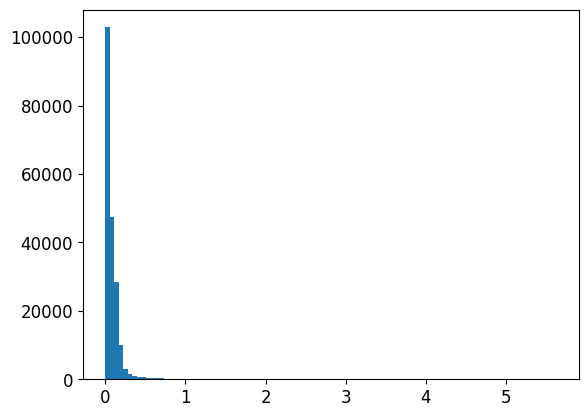

In [ ]:
# Plot abs_diff
plt.hist(results_df["abs_diff"], bins=100)

             target        output      abs_diff
count  5.816800e+04  58168.000000  58168.000000
mean   3.235118e-01      0.451150      0.248829
std    8.119179e-01      0.672444      0.397529
min    0.000000e+00     -1.591148      0.100001
25%    8.323679e-34      0.130656      0.122581
50%    2.585482e-07      0.168019      0.149432
75%    1.678031e-01      0.418218      0.195507
max    5.991320e+00      5.254680      5.628960


(array([3.8748e+04, 3.4030e+03, 1.7550e+03, 1.1710e+03, 9.7300e+02,
        8.5800e+02, 7.0600e+02, 7.2300e+02, 5.5000e+02, 5.3700e+02,
        3.6100e+02, 4.3500e+02, 4.2900e+02, 3.1200e+02, 2.9100e+02,
        3.7600e+02, 3.0100e+02, 2.5100e+02, 3.1100e+02, 3.2000e+02,
        2.1100e+02, 2.9200e+02, 2.7600e+02, 1.6700e+02, 2.8500e+02,
        1.6500e+02, 1.8700e+02, 2.3900e+02, 1.6700e+02, 2.4600e+02,
        1.4600e+02, 7.1000e+01, 1.7500e+02, 1.7200e+02, 7.8000e+01,
        1.1000e+02, 1.5200e+02, 9.4000e+01, 6.1000e+01, 1.7500e+02,
        6.0000e+01, 2.2000e+01, 9.8000e+01, 1.8200e+02, 0.0000e+00,
        6.2000e+01, 3.6000e+01, 6.9000e+01, 9.0000e+01, 1.1100e+02,
        2.8000e+01, 0.0000e+00, 3.7000e+01, 3.8000e+01, 2.8000e+01,
        3.2000e+01, 0.0000e+00, 4.1000e+01, 7.9000e+01, 7.4000e+01,
        8.3000e+01, 0.0000e+00, 3.5000e+01, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 4.7000e+01, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        4.0000e+01, 0.0000e+00, 0.0000e+00, 0.00

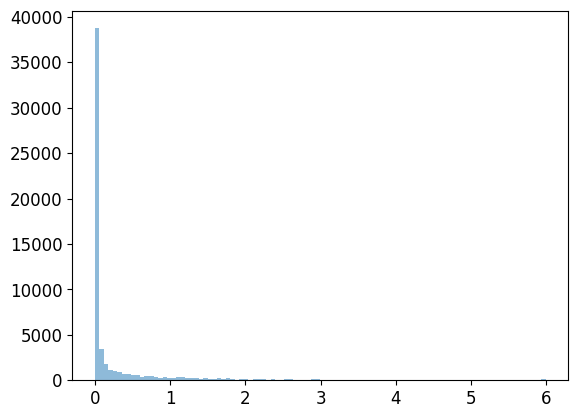

In [ ]:
# Get the ones where abs_diff is greater than 0.1
print(results_df[results_df["abs_diff"] > 0.1].describe())

# Plot the targets and outputs for this subset
plt.hist(results_df[results_df["abs_diff"] > 0.1]["target"], bins=100, alpha=0.5, label="target")

              target         output      abs_diff
count  141832.000000  141832.000000  1.418320e+05
mean        0.222103       0.245681  3.710838e-02
std         0.316735       0.308051  2.857957e-02
min         0.000000      -0.099916  5.960464e-08
25%         0.000280       0.052514  1.198867e-02
50%         0.083342       0.123957  3.028936e-02
75%         0.350395       0.363883  5.960438e-02
max         4.469090       4.481951  9.999739e-02


(array([6.2899e+04, 9.0910e+03, 6.4850e+03, 5.8420e+03, 5.3680e+03,
        5.3990e+03, 5.3880e+03, 7.1300e+03, 5.9500e+03, 4.7720e+03,
        3.6540e+03, 2.9300e+03, 2.2750e+03, 1.9540e+03, 1.6670e+03,
        1.4530e+03, 1.2360e+03, 1.0380e+03, 8.0200e+02, 7.3500e+02,
        6.7600e+02, 6.1700e+02, 5.0400e+02, 4.3900e+02, 4.0200e+02,
        3.7600e+02, 2.8200e+02, 2.7500e+02, 2.0000e+02, 2.2600e+02,
        1.5300e+02, 1.3700e+02, 1.4500e+02, 1.6400e+02, 6.5000e+01,
        1.2700e+02, 9.9000e+01, 9.4000e+01, 4.7000e+01, 1.2800e+02,
        2.7000e+01, 6.6000e+01, 3.3000e+01, 4.0000e+01, 5.4000e+01,
        3.5000e+01, 2.5000e+01, 4.3000e+01, 3.8000e+01, 1.0000e+00,
        2.8000e+01, 2.4000e+01, 3.8000e+01, 5.0000e+00, 1.5000e+01,
        1.0000e+00, 2.0000e+01, 3.0000e+00, 1.8000e+01, 0.0000e+00,
        2.1000e+01, 0.0000e+00, 7.0000e+00, 0.0000e+00, 7.0000e+00,
        3.0000e+00, 2.0000e+00, 8.0000e+00, 0.0000e+00, 1.0000e+01,
        0.0000e+00, 0.0000e+00, 1.2000e+01, 0.00

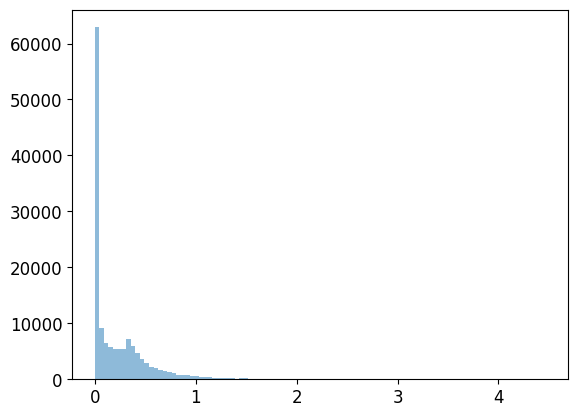

In [ ]:
# Plot hist for the ones with error under 0.1
print(results_df[results_df["abs_diff"] < 0.1].describe())
plt.hist(results_df[results_df["abs_diff"] < 0.1]["target"], bins=100, alpha=0.5, label="target")

Text(0.5, 0.98, 'Distribution of target values for different error levels')

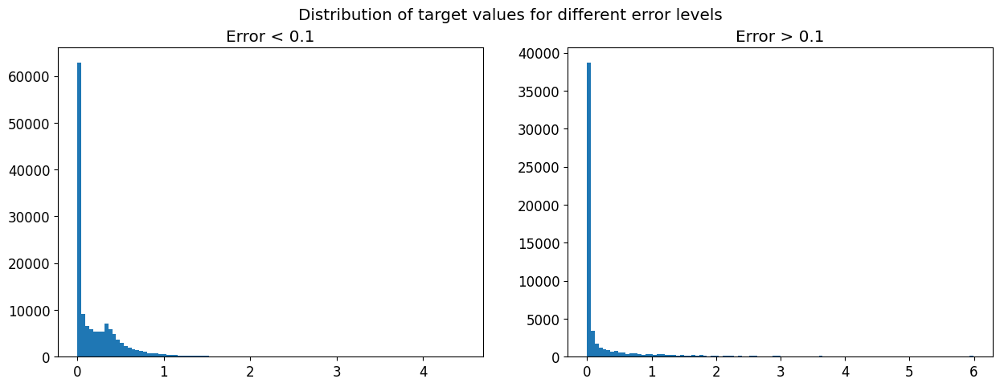

In [ ]:
# Plot hist for the ones with error under 0.1 and ones with error higher than 0.1 next to each other in two subplots
plt.rcParams.update({'font.size': 12})
fig, axs = plt.subplots(1, 2, figsize=(15, 5))
axs[0].hist(results_df[results_df["abs_diff"] < 0.1]["target"], bins=100, alpha=1, label="target")
axs[1].hist(results_df[results_df["abs_diff"] > 0.1]["target"], bins=100, alpha=1, label="target")
axs[0].set_title("Error < 0.1")
axs[1].set_title("Error > 0.1")

# Figure title
fig.suptitle("Distribution of target values for different error levels")
# Font size



In [ ]:
results2 = eval_loop(dataloader, snn_lin_out, mode="mean", apply_from=int(0.1*num_time_steps_per_sample))
results3 = eval_loop(dataloader, snn_lin_out, mode="mean", apply_from=int(0.2*num_time_steps_per_sample))
results4 = eval_loop(dataloader, snn_lin_out, mode="mean", apply_from=int(0.3*num_time_steps_per_sample))
results5 = eval_loop(dataloader, snn_lin_out, mode="mean", apply_from=int(0.4*num_time_steps_per_sample))
results6 = eval_loop(dataloader, snn_lin_out, mode="mean", apply_from=int(0.5*num_time_steps_per_sample))

results_df2 = pd.DataFrame(results2, columns=["target", "output"])
results_df3 = pd.DataFrame(results3, columns=["target", "output"])
results_df4 = pd.DataFrame(results4, columns=["target", "output"])
results_df5 = pd.DataFrame(results5, columns=["target", "output"])
results_df6 = pd.DataFrame(results6, columns=["target", "output"])

results_df2["abs_diff"] = abs(results_df2["target"] - results_df2["output"])
results_df3["abs_diff"] = abs(results_df3["target"] - results_df3["output"])
results_df4["abs_diff"] = abs(results_df4["target"] - results_df4["output"])
results_df5["abs_diff"] = abs(results_df5["target"] - results_df5["output"])
results_df6["abs_diff"] = abs(results_df6["target"] - results_df6["output"])

print(f"Max error for 0.1: {results_df2['abs_diff'].max()}; mean error: {results_df2['abs_diff'].mean()}")
print(f"Max error for 0.2: {results_df3['abs_diff'].max()}; mean error: {results_df3['abs_diff'].mean()}")
print(f"Max error for 0.3: {results_df4['abs_diff'].max()}; mean error: {results_df4['abs_diff'].mean()}")
print(f"Max error for 0.4: {results_df5['abs_diff'].max()}; mean error: {results_df5['abs_diff'].mean()}")
print(f"Max error for 0.5: {results_df6['abs_diff'].max()}; mean error: {results_df6['abs_diff'].mean()}")

  0%|          | 0/196 [00:00<?, ?it/s]

  0%|          | 0/196 [00:00<?, ?it/s]

  0%|          | 0/196 [00:00<?, ?it/s]

  0%|          | 0/196 [00:00<?, ?it/s]

  0%|          | 0/196 [00:00<?, ?it/s]

Max error for 0.1: 5.7054083943367; mean error: 0.07685111895743575
Max error for 0.2: 5.850260347127914; mean error: 0.0653396289020209
Max error for 0.3: 6.161204665899277; mean error: 0.06327026453739948
Max error for 0.4: 6.708493709564209; mean error: 0.06344861973710156
Max error for 0.5: 6.974140405654907; mean error: 0.06433400149036894


In [ ]:


print(f"MSE for 0.0: {mean_squared_error(results_df['target'], results_df['output'])}")
print(f"MSE for 0.1: {mean_squared_error(results_df2['target'], results_df2['output'])}")
print(f"MSE for 0.2: {mean_squared_error(results_df3['target'], results_df3['output'])}")
print(f"MSE for 0.3: {mean_squared_error(results_df4['target'], results_df4['output'])}")
print(f"MSE for 0.4: {mean_squared_error(results_df5['target'], results_df5['output'])}")
print(f"MSE for 0.5: {mean_squared_error(results_df6['target'], results_df6['output'])}")


print(f"R2 for 0.0: {r2_score(results_df['target'], results_df['output'])}")
print(f"R2 for 0.1: {r2_score(results_df2['target'], results_df2['output'])}")
print(f"R2 for 0.2: {r2_score(results_df3['target'], results_df3['output'])}")
print(f"R2 for 0.3: {r2_score(results_df4['target'], results_df4['output'])}")
print(f"R2 for 0.4: {r2_score(results_df5['target'], results_df5['output'])}")
print(f"R2 for 0.5: {r2_score(results_df6['target'], results_df6['output'])}")

MSE for 0.0: 0.06552392864340449
MSE for 0.1: 0.0624861489435436
MSE for 0.2: 0.061541087940474457
MSE for 0.3: 0.06440711110039554
MSE for 0.4: 0.06892187655326822
MSE for 0.5: 0.07111748994571016
R2 for 0.0: 0.752726544732256
R2 for 0.1: 0.7641904831480185
R2 for 0.2: 0.7677569435924081
R2 for 0.3: 0.7569411780499005
R2 for 0.4: 0.73990340762971
R2 for 0.5: 0.7316176268283797


In [ ]:
# Test for 0.8 and 0.9
results8 = eval_loop(dataloader, snn_lin_out, mode="mean", apply_from=int(0.8*num_time_steps_per_sample))
results9 = eval_loop(dataloader, snn_lin_out, mode="mean", apply_from=int(0.9*num_time_steps_per_sample))

results_df8 = pd.DataFrame(results8, columns=["target", "output"])
results_df9 = pd.DataFrame(results9, columns=["target", "output"])

results_df8["abs_diff"] = abs(results_df8["target"] - results_df8["output"])
results_df9["abs_diff"] = abs(results_df9["target"] - results_df9["output"])

print(f"Max error for 0.8: {results_df8['abs_diff'].max()}; mean error: {results_df8['abs_diff'].mean()}")
print(f"Max error for 0.9: {results_df9['abs_diff'].max()}; mean error: {results_df9['abs_diff'].mean()}")

print(f"MSE for 0.8: {mean_squared_error(results_df8['target'], results_df8['output'])}")
print(f"MSE for 0.9: {mean_squared_error(results_df9['target'], results_df9['output'])}")
print(f"R2 for 0.8: {r2_score(results_df8['target'], results_df8['output'])}")
print(f"R2 for 0.9: {r2_score(results_df9['target'], results_df9['output'])}")

  0%|          | 0/196 [00:00<?, ?it/s]

  0%|          | 0/196 [00:00<?, ?it/s]

Max error for 0.8: 6.698530435562134; mean error: 0.06607549225012657
Max error for 0.9: 7.7754281759262085; mean error: 0.10113612208570225
MSE for 0.8: 0.05628230206419468
MSE for 0.9: 0.0723858465784956
R2 for 0.8: 0.7876024898083218
R2 for 0.9: 0.7268311170205282


In [ ]:
# 06 and 07
results6 = eval_loop(dataloader, snn_lin_out, mode="mean", apply_from=int(0.6*num_time_steps_per_sample))
results7 = eval_loop(dataloader, snn_lin_out, mode="mean", apply_from=int(0.7*num_time_steps_per_sample))

results_df6 = pd.DataFrame(results6, columns=["target", "output"])
results_df7 = pd.DataFrame(results7, columns=["target", "output"])

results_df6["abs_diff"] = abs(results_df6["target"] - results_df6["output"])
results_df7["abs_diff"] = abs(results_df7["target"] - results_df7["output"])

print(f"Max error for 0.6: {results_df6['abs_diff'].max()}; mean error: {results_df6['abs_diff'].mean()}")
print(f"Max error for 0.7: {results_df7['abs_diff'].max()}; mean error: {results_df7['abs_diff'].mean()}")

print(f"MSE for 0.6: {mean_squared_error(results_df6['target'], results_df6['output'])}")
print(f"MSE for 0.7: {mean_squared_error(results_df7['target'], results_df7['output'])}")
print(f"R2 for 0.6: {r2_score(results_df6['target'], results_df6['output'])}")
print(f"R2 for 0.7: {r2_score(results_df7['target'], results_df7['output'])}")

  0%|          | 0/196 [00:00<?, ?it/s]

  0%|          | 0/196 [00:00<?, ?it/s]

Max error for 0.6: 7.064499139785767; mean error: 0.16127472297848863
Max error for 0.7: 7.188853144645691; mean error: 0.16528735296986327
MSE for 0.6: 0.17058726230802568
MSE for 0.7: 0.17389180527613948
R2 for 0.6: 0.35623973334791115
R2 for 0.7: 0.34376908675018947


In [ ]:
import numpy as np
import plotly.express as px
import math

class SpiceSOM(nn.Module):
    """Run value(s) through a SPICEnet SOM with a single SNN acting as the SOM Neuron.
    The single SNN improves the efficiency of the SOM by running all neurons in parallel.

    Parameters:
        standard_deviation: list of standard deviations for all neurons in order of neurons.
        preferred_value: list of preferred values for all neurons in order of neurons.
        timesteps: The number of timesteps to run the SNN for.
    """
    def __init__(self,
                n_neurons: int,
                value_range_start: float,
                value_range_end: float,
                const_LR_interaction_kernel: float,
                const_LR_tuning_curve: float,
                timesteps: int):
        super().__init__()
        self.__iteration = 0
        self.const_LR_interaction_kernel = const_LR_interaction_kernel
        self.const_LR_tuning_curve = const_LR_tuning_curve
        
        distance = value_range_end - value_range_start
        step_size = distance / n_neurons
        
        self.preferred_value = []
        self.standard_deviation = []
        
        pos = value_range_start + step_size / 2.0

        for i in range(n_neurons):
            self.preferred_value.append(pos)
            self.standard_deviation.append(0.005)
            pos += step_size
            
        self.preferred_value = self.preferred_value
        self.standard_deviation = self.standard_deviation
        
        self.timesteps = timesteps
        
        self.som_snn = [snn_lin_out]

    @classmethod
    def from_lists(
        cls,
        standard_deviation: list[float],
        preferred_value: list[float],
        value_range_start: float,
        value_range_end: float,
        const_LR_interaction_kernel: float,
        const_LR_tuning_curve: float,
        timesteps: int,
    ):
        som = cls(len(standard_deviation), value_range_start, value_range_end, const_LR_interaction_kernel, const_LR_tuning_curve, timesteps)
        
        som.standard_deviation = standard_deviation
        som.preferred_value = preferred_value
        
        return som

    def forward(self, input: torch.Tensor) -> torch.Tensor:
        # Check input is the correct shape
        if input.dim() != 1:
            raise ValueError(f"Input must be 1D, got {input.dim()}D")
        
        result = []
        
        std_tensor = torch.Tensor(self.standard_deviation)
        pref_tensor = torch.Tensor(self.preferred_value)
        
        # Make std and prefered value the same shape as the input
        for value in input.tolist():
            # stack the input, std and prefered value
            repeated_value = torch.full_like(std_tensor, value)
            input = torch.stack((repeated_value, pref_tensor, std_tensor), dim=1)
            
            # Repeat the input for the number of timesteps
            input = input.repeat(self.timesteps, 1, 1)
            
            with torch.no_grad():
                subresult = self.som_snn[0](input)
            result.append(subresult)
            
        # Transform result from list of answers for each neuron to list of activation vectors of each neuron for a value
        result = torch.stack(result, dim=0)
        
        # Descale
        return result[:, 50:, :, :].mean(dim=1)
    
    def __len__(self) -> int:
        return len(self.standard_deviation)
    
    def print_neurons(self):
        for i, (pref_val, std) in enumerate(zip(self.preferred_value, self.standard_deviation)):
            print(f"Neuron {i}: preferred value: {pref_val}, standard deviation: {std}")
            
    
    def fit(self, values: list[float], epochs: int):
        for epoch in range(epochs):
            for i in range(len(values)):
                winning_neuron_index, _ = self.__argmax_neuron_activation(values[i])

                for j in range(len(self.preferred_value)):
                    self.update_neuron(j, values[i],
                                             self.const_LR_tuning_curve, # Only constant LR
                                             self.const_LR_interaction_kernel, # Only constant LR
                                             j - winning_neuron_index)
                self.__iteration += 1
                
    def __argmax_neuron_activation(self, value: float):
        """
        Calculates the neuron with the highest activation value.
        :param value: The value for wich the activation values should be calculated.
        :return: The index of the winning neuron
        and a dictionary containing the index of a neuron with the calculated activation value.
        """
        # Get activation values over timesteps
        results = self.forward(torch.Tensor([value]))
        
        # Get the mean activation value over timesteps
        winner_neuron_values = results[0, :, 0]
        
        # Get the index of the winning neuron
        winner_neuron_index = torch.argmax(winner_neuron_values).item()
        activation_dict = {i: winner_neuron_values[i].item() for i in range(len(winner_neuron_values))}
        
        return winner_neuron_index, activation_dict
        
    def update_neuron(self, index: int, value: float, learn_rate: float, interaction_kernel_learning_rate: float,
                distance_to_winner: int):
        """
        Updates the weights of the neurons.
        :param index: index of the neuron to update
        :param value: The value in wich "direction" the neuron should move.
        :param learn_rate: The learn rate. (This value should be depending on the iteration.)
        :param interaction_kernel_learning_rate: The sigma of the interaction kernel.
        (This value should be depending on the iteration.)
        :param distance_to_winner: The distance between this neuron and the winning neuron, in the SOM.
        Here are not the weights / postions in the value range relevant.
        (N1 weight: 31.9) --- (N2 weight: 32) --- (N3 weight: 32.4) --- (N4 weight: 33)
        The Distance of N4 to N1 is 3
        :return:
        """
        interaction_kernel_value = math.exp(
            (-abs(distance_to_winner) ** 2) / (2 * interaction_kernel_learning_rate ** 2))
        self.preferred_value[index] += learn_rate * interaction_kernel_value * (value - self.preferred_value[index])
        self.standard_deviation[index] += learn_rate * interaction_kernel_value * (
                (value - self.preferred_value[index]) ** 2 - self.standard_deviation[index] ** 2
        )
        
    def all_activation_for_values(self, values: list[float]):
        """
        Returns the activation values for a list of values.
        :param values: The values for wich the activation has to be calculated.
        :return: An array of activation values, ordered like the input list.
        """
        return np.array([self.get_activation_vector(value) for value in values]).T

        
    def calculate_activation_values(self, values: list[float]):
        """
        Calculates activation values for all neurons in the som.
        :param values:
        :return: A numpy array the first col is the preferred value, second col is the tuning curve width
        and the following cols are the activation values.
        """
        activation_values = np.array(self.all_activation_for_values(values))
        return np.concatenate((
            np.array(
                [[pref for pref in self.preferred_value],
                 [std for std in self.standard_deviation]]).transpose(),
            activation_values),
            axis=1)

    def naive_decode(self, value: float, neuron_index: int) -> float:
        activation_value = value
        
        r = math.sqrt(2 * self.standard_deviation[neuron_index] ** 2 * math.log(
            math.sqrt(2 * math.pi) * activation_value * self.standard_deviation[neuron_index] ** 2, 10))

        if neuron_index < len(self.standard_deviation) / 2:
            return self.preferred_value[neuron_index] - r
        else:
            return self.preferred_value[neuron_index] + r
        
    def get_winning_neuron_index(self, value: float) -> tuple[int, float]:
        winning_neuron_index, activation_values = self.__argmax_neuron_activation(value)
        return winning_neuron_index, activation_values[winning_neuron_index]
    
    def get_activation_vector(self, value: float) -> np.array:
        # Get activation values over timesteps
        results = self.forward(torch.Tensor([value]))
        
        # Get the mean activation value over timesteps
        winner_neuron_values = results[0, :, 0]
        
        return np.array(winner_neuron_values.tolist())
    

    def get_as_matrix(self) -> np.ndarray:
        """
        Returns all neurons like a table with column 0 representing the preferred value
        and column 1 representing the tuning curve width.
        :return: A numpy matrix.
        """
        return np.array([self.preferred_value,
                         self.standard_deviation]).transpose()

def plot_som(som, select_all_button: bool = False):
    stem_x_values = som.get_as_matrix()[:, 0]
    x_min = stem_x_values.min()
    x_max = stem_x_values.max()
    distance = x_max - x_min
    x_min -= distance * 0.15
    x_max += distance * 0.15
    x_plt_vals = np.linspace(x_min, x_max, 3000)
    activation_values = np.expm1(som.calculate_activation_values(x_plt_vals.tolist()))
    df = pd.DataFrame(activation_values[:, 2:].transpose(), index=x_plt_vals)
    fig = px.line(df)
    if select_all_button:
        fig.update_layout(dict(updatemenus=[
            dict(
                type="buttons",
                direction="left",
                buttons=list([
                    dict(
                        args=["visible", "legendonly"],
                        label="Deselect All",
                        method="restyle"
                    ),
                    dict(
                        args=["visible", True],
                        label="Select All",
                        method="restyle"
                    )
                ]),
                pad={"r": 10, "t": 10},
                showactive=False,
                x=1,
                xanchor="right",
                y=1.1,
                yanchor="top"
            ),
        ]
        ))
    fig.show(title='Activation values')


In [ ]:
som = SpiceSOM(100, -1, 1, 0.8, 0.8, 100)

In [ ]:
plot_som(som)

In [ ]:
import numpy as np
import plotly.express as px
import math

class OriginalSOM(nn.Module):
    """Run value(s) through a SPICEnet SOM with a single SNN acting as the SOM Neuron.
    The single SNN improves the efficiency of the SOM by running all neurons in parallel.

    Parameters:
        standard_deviation: list of standard deviations for all neurons in order of neurons.
        preferred_value: list of preferred values for all neurons in order of neurons.
        timesteps: The number of timesteps to run the SNN for.
    """
    def __init__(self,
                n_neurons: int,
                value_range_start: float,
                value_range_end: float,
                const_LR_interaction_kernel: float,
                const_LR_tuning_curve: float,
                timesteps: int):
        super().__init__()
        self.__iteration = 0
        self.const_LR_interaction_kernel = const_LR_interaction_kernel
        self.const_LR_tuning_curve = const_LR_tuning_curve
        
        distance = value_range_end - value_range_start
        step_size = distance / n_neurons
        
        self.preferred_value = []
        self.standard_deviation = []
        
        pos = value_range_start + step_size / 2.0

        for i in range(n_neurons):
            self.preferred_value.append(pos)
            self.standard_deviation.append(0.005)
            pos += step_size
            
        self.preferred_value = self.preferred_value
        self.standard_deviation = self.standard_deviation
        
        self.timesteps = timesteps
        
        self.ann = [ann]

    @classmethod
    def from_lists(
        cls,
        standard_deviation: list[float],
        preferred_value: list[float],
        value_range_start: float,
        value_range_end: float,
        const_LR_interaction_kernel: float,
        const_LR_tuning_curve: float,
        timesteps: int,
    ):
        som = cls(len(standard_deviation), value_range_start, value_range_end, const_LR_interaction_kernel, const_LR_tuning_curve, timesteps)
        
        som.standard_deviation = standard_deviation
        som.preferred_value = preferred_value
        
        return som

    def forward(self, input: torch.Tensor) -> torch.Tensor:
        # Check input is the correct shape
        if input.dim() != 1:
            raise ValueError(f"Input must be 1D, got {input.dim()}D")
        
        result = []
        
        std_tensor = torch.Tensor(self.standard_deviation)
        pref_tensor = torch.Tensor(self.preferred_value)
        
        # Make std and prefered value the same shape as the input
        for value in input.tolist():
            # stack the input, std and prefered value
            repeated_value = torch.full_like(std_tensor, value)
            input = torch.stack((repeated_value, pref_tensor, std_tensor), dim=1)
            
            # Repeat the input for the number of timesteps
            #input = input.repeat(self.timesteps, 1, 1)
            
            with torch.no_grad():
                subresult = self.ann[0](input)
            result.append(subresult)
            
        # Transform result from list of answers for each neuron to list of activation vectors of each neuron for a value
        result = torch.stack(result, dim=0)
        
        # Descale
        return result[:, :, :]
    
    def __len__(self) -> int:
        return len(self.standard_deviation)
    
    def print_neurons(self):
        for i, (pref_val, std) in enumerate(zip(self.preferred_value, self.standard_deviation)):
            print(f"Neuron {i}: preferred value: {pref_val}, standard deviation: {std}")
            
    
    def fit(self, values: list[float], epochs: int):
        for epoch in range(epochs):
            for i in range(len(values)):
                winning_neuron_index, _ = self.__argmax_neuron_activation(values[i])

                for j in range(len(self.preferred_value)):
                    self.update_neuron(j, values[i],
                                             self.const_LR_tuning_curve, # Only constant LR
                                             self.const_LR_interaction_kernel, # Only constant LR
                                             j - winning_neuron_index)
                self.__iteration += 1
                
    def __argmax_neuron_activation(self, value: float):
        """
        Calculates the neuron with the highest activation value.
        :param value: The value for wich the activation values should be calculated.
        :return: The index of the winning neuron
        and a dictionary containing the index of a neuron with the calculated activation value.
        """
        # Get activation values over timesteps
        results = self.forward(torch.Tensor([value]))
        
        # Get the mean activation value over timesteps
        winner_neuron_values = results[0, :, 0]
        
        # Get the index of the winning neuron
        winner_neuron_index = torch.argmax(winner_neuron_values).item()
        activation_dict = {i: winner_neuron_values[i].item() for i in range(len(winner_neuron_values))}
        
        return winner_neuron_index, activation_dict
        
    def update_neuron(self, index: int, value: float, learn_rate: float, interaction_kernel_learning_rate: float,
                distance_to_winner: int):
        """
        Updates the weights of the neurons.
        :param index: index of the neuron to update
        :param value: The value in wich "direction" the neuron should move.
        :param learn_rate: The learn rate. (This value should be depending on the iteration.)
        :param interaction_kernel_learning_rate: The sigma of the interaction kernel.
        (This value should be depending on the iteration.)
        :param distance_to_winner: The distance between this neuron and the winning neuron, in the SOM.
        Here are not the weights / postions in the value range relevant.
        (N1 weight: 31.9) --- (N2 weight: 32) --- (N3 weight: 32.4) --- (N4 weight: 33)
        The Distance of N4 to N1 is 3
        :return:
        """
        interaction_kernel_value = math.exp(
            (-abs(distance_to_winner) ** 2) / (2 * interaction_kernel_learning_rate ** 2))
        self.preferred_value[index] += learn_rate * interaction_kernel_value * (value - self.preferred_value[index])
        self.standard_deviation[index] += learn_rate * interaction_kernel_value * (
                (value - self.preferred_value[index]) ** 2 - self.standard_deviation[index] ** 2
        )
        
    def all_activation_for_values(self, values: list[float]):
        """
        Returns the activation values for a list of values.
        :param values: The values for wich the activation has to be calculated.
        :return: An array of activation values, ordered like the input list.
        """
        return np.array([self.get_activation_vector(value) for value in values]).T

        
    def calculate_activation_values(self, values: list[float]):
        """
        Calculates activation values for all neurons in the som.
        :param values:
        :return: A numpy array the first col is the preferred value, second col is the tuning curve width
        and the following cols are the activation values.
        """
        activation_values = np.array(self.all_activation_for_values(values))
        return np.concatenate((
            np.array(
                [[pref for pref in self.preferred_value],
                 [std for std in self.standard_deviation]]).transpose(),
            activation_values),
            axis=1)

    def naive_decode(self, value: float, neuron_index: int) -> float:
        activation_value = value
        
        r = math.sqrt(2 * self.standard_deviation[neuron_index] ** 2 * math.log(
            math.sqrt(2 * math.pi) * activation_value * self.standard_deviation[neuron_index] ** 2, 10))

        if neuron_index < len(self.standard_deviation) / 2:
            return self.preferred_value[neuron_index] - r
        else:
            return self.preferred_value[neuron_index] + r
        
    def get_winning_neuron_index(self, value: float) -> tuple[int, float]:
        winning_neuron_index, activation_values = self.__argmax_neuron_activation(value)
        return winning_neuron_index, activation_values[winning_neuron_index]
    
    def get_activation_vector(self, value: float) -> np.array:
        # Get activation values over timesteps
        results = self.forward(torch.Tensor([value]))
        
        # Get the mean activation value over timesteps
        winner_neuron_values = results[0, :, 0]
        
        return np.array(winner_neuron_values.tolist())
    

    def get_as_matrix(self) -> np.ndarray:
        """
        Returns all neurons like a table with column 0 representing the preferred value
        and column 1 representing the tuning curve width.
        :return: A numpy matrix.
        """
        return np.array([self.preferred_value,
                         self.standard_deviation]).transpose()


In [ ]:
originalsom = OriginalSOM(100, -1, 1, 0.8, 0.8, 100)

In [ ]:
plot_som(originalsom)

In [ ]:
# Save SNN model wit TorchScript to be able to load without class definition
#torch.save(snn_lin_out.spiking_model, "snn_lin_out.pt")

In [ ]:
# Export to NIR
# from sinabs import to_nir, from_nir
# from  sinabs.activation.reset_mechanism import MembraneSubtract

# nir_model = to_nir(snn_lin_out.spiking_model, test_dataset[0][0], "snn_lin_out")

# import norse.torch as norse

# norse_model = norse.from_nir(nir_model, reset_method=norse.reset_subtract)

# norse_model

GraphExecutor(
  (input): Identity()
  (0): Linear(in_features=3, out_features=256, bias=True)
  (1): IAFCell(
    p=IAFParameters(v_th=tensor([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
            1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
            1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
            1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
            1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
            1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
            1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
            1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
            1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
            1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
            1., 1., 1., 1., 

In [ ]:
# for name, layer in norse_model.named_children():
#     if isinstance(layer, torch.nn.Linear):
#         print(name)
#         snn_lin_out_weights = snn_lin_out.spiking_model[int(name)].state_dict()['weight']
#         snn_lin_out_bias = snn_lin_out.spiking_model[int(name)].state_dict()['bias']
        
#         assert torch.allclose(layer.state_dict()['weight'], snn_lin_out_weights), f"Layer {name} weights are not equal"
#         assert torch.allclose(layer.state_dict()['bias'], snn_lin_out_bias), f"Layer {name} biases are not equal"

0
2
4
6


In [ ]:
# batch_1_dataloader = torch.utils.data.DataLoader(test_dataset, batch_size=1, shuffle=False)

# results_norse = eval_loop(dataloader, norse_model, is_norse=True)

  0%|          | 0/196 [00:00<?, ?it/s]

Data shape: torch.Size([100, 1024, 3])
torch.Size([100, 1024, 1])
Data shape: torch.Size([100, 1024, 3])
torch.Size([100, 1024, 1])
Data shape: torch.Size([100, 1024, 3])
torch.Size([100, 1024, 1])
Data shape: torch.Size([100, 1024, 3])
torch.Size([100, 1024, 1])
Data shape: torch.Size([100, 1024, 3])
torch.Size([100, 1024, 1])
Data shape: torch.Size([100, 1024, 3])
torch.Size([100, 1024, 1])
Data shape: torch.Size([100, 1024, 3])
torch.Size([100, 1024, 1])
Data shape: torch.Size([100, 1024, 3])
torch.Size([100, 1024, 1])
Data shape: torch.Size([100, 1024, 3])
torch.Size([100, 1024, 1])
Data shape: torch.Size([100, 1024, 3])
torch.Size([100, 1024, 1])
Data shape: torch.Size([100, 1024, 3])
torch.Size([100, 1024, 1])
Data shape: torch.Size([100, 1024, 3])
torch.Size([100, 1024, 1])
Data shape: torch.Size([100, 1024, 3])
torch.Size([100, 1024, 1])
Data shape: torch.Size([100, 1024, 3])
torch.Size([100, 1024, 1])
Data shape: torch.Size([100, 1024, 3])
torch.Size([100, 1024, 1])
Data shape

In [ ]:
# results_df_norse = pd.DataFrame(results_norse, columns=["target", "output", "model_output"])
# results_df_norse["abs_diff"] = abs(results_df_norse["target"] - results_df_norse["output"])
# results_df_norse.head()

,target,output,model_output,abs_diff
0,0.036083,0.045391,"[[[tensor(0.0454)], [tensor(0.0454)], [tensor(...",0.009308
1,0.061312,0.045391,"[[[tensor(0.0454)], [tensor(0.0454)], [tensor(...",0.015921
2,0.023691,0.045391,"[[[tensor(0.0454)], [tensor(0.0454)], [tensor(...",0.021700
3,0.622410,0.045391,"[[[tensor(0.0454)], [tensor(0.0454)], [tensor(...",0.577019
4,0.116947,0.045391,"[[[tensor(0.0454)], [tensor(0.0454)], [tensor(...",0.071556


In [ ]:
# # Metrics
# print(f"Max error for norse: {results_df_norse['abs_diff'].max()}; mean error: {results_df_norse['abs_diff'].mean()}")
# print(f"MSE for norse: {mean_squared_error(results_df_norse['target'], results_df_norse['output'])}")
# print(f"R2 for norse: {r2_score(results_df_norse['target'], results_df_norse['output'])}")

Max error for norse: 3.9440310560166836; mean error: 0.10447808228115227
MSE for norse: 0.09407019632694077
R2 for norse: -0.044375330335329366


# First results
We can see that on average our results are pretty okay with the the mean absolute difference being around 0.01, with some having larger error, specifically those that would have a higher target number anyways reaching an error of up to 0.7.

We can also see that if we give the SNN some time to reach around the target and only take the average of, for example, the second half of the timesteps our results improve again by a good amount.

Most records with small targets also have small error, showing some sort of correlation here.

We want to now see how the outputs look if we were to count spike outputs for each input

In [ ]:
from sinabs.activation import MembraneReset, SingleSpike, MultiSpike, MembraneSubtract

snn_spike_out = sinabs.from_model(ann, input_shape=(3,), add_spiking_output=False, synops=False, num_timesteps=num_time_steps_per_sample, spike_threshold=torch.tensor(1),
                                  min_v_mem=-1,
                                  spike_fn=SingleSpike)
snn_spike_out

Network(
  (spiking_model): Sequential(
    (0): Linear(in_features=3, out_features=256, bias=True)
    (1): IAFSqueeze(spike_threshold=Parameter containing:
    tensor(1), min_v_mem=Parameter containing:
    tensor(-1), batch_size=-1, num_timesteps=100)
    (2): Linear(in_features=256, out_features=256, bias=True)
    (3): IAFSqueeze(spike_threshold=Parameter containing:
    tensor(1), min_v_mem=Parameter containing:
    tensor(-1), batch_size=-1, num_timesteps=100)
    (4): Linear(in_features=256, out_features=256, bias=True)
    (5): IAFSqueeze(spike_threshold=Parameter containing:
    tensor(1), min_v_mem=Parameter containing:
    tensor(-1), batch_size=-1, num_timesteps=100)
    (6): Linear(in_features=256, out_features=1, bias=True)
  )
  (analog_model): Sequential(
    (0): Linear(in_features=3, out_features=256, bias=True)
    (1): ReLU()
    (2): Linear(in_features=256, out_features=256, bias=True)
    (3): ReLU()
    (4): Linear(in_features=256, out_features=256, bias=True)
 

In [ ]:
results = eval_loop(dataloader, snn_spike_out, mode="count")
results_df_count = pd.DataFrame(results, columns=["target", "count"])

  0%|          | 0/196 [00:00<?, ?it/s]

In [ ]:
results_df_count["target/count"] = results_df_count["target"] / results_df_count["count"]

In [ ]:
results_df_count.head()

,target,count,target/count
0,0.036083,87,0.000415
1,0.061312,90,0.000681
2,0.023691,87,0.000272
3,0.622410,95,0.006552
4,0.116947,75,0.001559


In [ ]:
results_df_count.describe()

,target,count,target/count
count,2.000000e+05,200000.000000,2.000000e+05
mean,1.086131e-01,83.185865,1.311068e-03
std,3.001227e-01,5.622324,3.672853e-03
min,0.000000e+00,42.000000,0.000000e+00
25%,2.247868e-08,80.000000,2.767927e-10
50%,3.664592e-02,84.000000,4.331738e-04
75%,9.494516e-02,87.000000,1.134101e-03
max,3.989422e+00,100.000000,6.770100e-02


In [ ]:
results_df_count[results_df_count["count"] == 50].describe()

,target,count,target/count
count,3.700000e+01,37.0,3.700000e+01
mean,2.743700e-03,50.0,5.487400e-05
std,7.334097e-03,0.0,1.466819e-04
min,0.000000e+00,50.0,0.000000e+00
25%,0.000000e+00,50.0,0.000000e+00
50%,3.987227e-13,50.0,7.974454e-15
75%,3.987228e-05,50.0,7.974457e-07
max,2.914367e-02,50.0,5.828734e-04


(array([1.0000e+00, 2.0000e+00, 0.0000e+00, 5.0000e+00, 0.0000e+00,
        9.0000e+00, 1.1000e+01, 0.0000e+00, 1.1000e+01, 0.0000e+00,
        1.2000e+01, 0.0000e+00, 2.1000e+01, 3.7000e+01, 0.0000e+00,
        3.1000e+01, 0.0000e+00, 5.3000e+01, 7.5000e+01, 0.0000e+00,
        8.3000e+01, 0.0000e+00, 1.2200e+02, 0.0000e+00, 1.4100e+02,
        1.6100e+02, 0.0000e+00, 1.8100e+02, 0.0000e+00, 2.0100e+02,
        0.0000e+00, 2.1400e+02, 2.1000e+02, 0.0000e+00, 2.2800e+02,
        0.0000e+00, 2.6000e+02, 2.7200e+02, 0.0000e+00, 2.5700e+02,
        0.0000e+00, 3.1900e+02, 0.0000e+00, 3.0000e+02, 3.7200e+02,
        0.0000e+00, 4.7800e+02, 0.0000e+00, 6.3800e+02, 0.0000e+00,
        8.1400e+02, 1.2170e+03, 0.0000e+00, 1.7130e+03, 0.0000e+00,
        2.2640e+03, 3.2680e+03, 0.0000e+00, 4.6280e+03, 0.0000e+00,
        6.0400e+03, 0.0000e+00, 7.8290e+03, 9.6060e+03, 0.0000e+00,
        1.1470e+04, 0.0000e+00, 1.2970e+04, 1.4761e+04, 0.0000e+00,
        1.5635e+04, 0.0000e+00, 1.6498e+04, 0.00

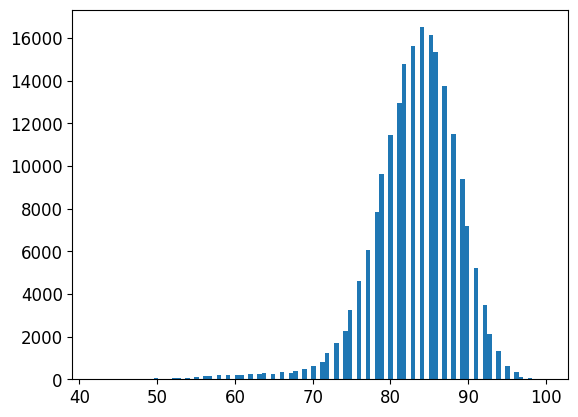

In [ ]:
plt.hist(results_df_count["count"], bins=100)

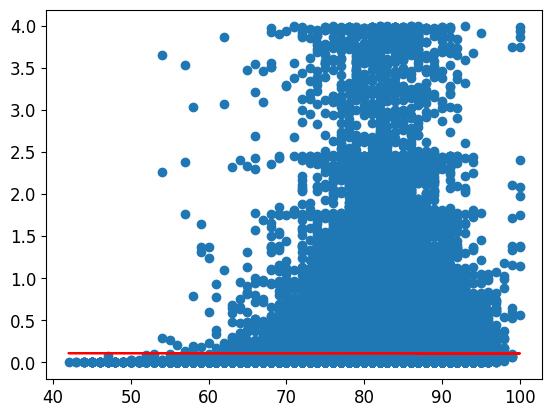

In [ ]:
# Plot x as count and y as target

plt.scatter(results_df_count["count"], results_df_count["target"])

# Add regression line
import numpy as np
from sklearn.linear_model import LinearRegression

X = results_df_count["count"].values.reshape(-1, 1)
y = results_df_count["target"].values

reg = LinearRegression().fit(X, y)

plt.plot(X, reg.predict(X), color='red')
